In [1]:
# Standard imports
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
import random
import copy

In [2]:
# QWERTY Keyboard layout data
keys = {
    # Number row
    '`': {'pos': (0, 4), 'start': 'a'},
    '1': {'pos': (1, 4), 'start': 'a'},
    '2': {'pos': (2, 4), 'start': 'a'},
    '3': {'pos': (3, 4), 'start': 's'},
    '4': {'pos': (4, 4), 'start': 'd'},
    '5': {'pos': (5, 4), 'start': 'f'},
    '6': {'pos': (6, 4), 'start': 'j'},
    '7': {'pos': (7, 4), 'start': 'j'},
    '8': {'pos': (8, 4), 'start': 'k'},
    '9': {'pos': (9, 4), 'start': 'l'},
    '0': {'pos': (10, 4), 'start': ';'},
    '-': {'pos': (11, 4), 'start': ';'},
    '=': {'pos': (12, 4), 'start': ';'},
    
    # Top letter row
    'q': {'pos': (1.5, 3), 'start': 'a'},
    'w': {'pos': (2.5, 3), 'start': 's'},
    'e': {'pos': (3.5, 3), 'start': 'd'},
    'r': {'pos': (4.5, 3), 'start': 'f'},
    't': {'pos': (5.5, 3), 'start': 'f'},
    'y': {'pos': (6.5, 3), 'start': 'j'},
    'u': {'pos': (7.5, 3), 'start': 'j'},
    'i': {'pos': (8.5, 3), 'start': 'k'},
    'o': {'pos': (9.5, 3), 'start': 'l'},
    'p': {'pos': (10.5, 3), 'start': ';'},
    '[': {'pos': (11.5, 3), 'start': ';'},
    ']': {'pos': (12.5, 3), 'start': ';'},
    '\\': {'pos': (13.5, 3), 'start': ';'},
    
    # Home row
    'a': {'pos': (1.75, 2), 'start': 'a'},
    's': {'pos': (2.75, 2), 'start': 's'},
    'd': {'pos': (3.75, 2), 'start': 'd'},
    'f': {'pos': (4.75, 2), 'start': 'f'},
    'g': {'pos': (5.75, 2), 'start': 'f'},
    'h': {'pos': (6.75, 2), 'start': 'j'},
    'j': {'pos': (7.75, 2), 'start': 'j'},
    'k': {'pos': (8.75, 2), 'start': 'k'},
    'l': {'pos': (9.75, 2), 'start': 'l'},
    ';': {'pos': (10.75, 2), 'start': ';'},
    "'": {'pos': (11.75, 2), 'start': ';'},
    
    # Bottom letter row
    'z': {'pos': (2.25, 1), 'start': 'a'},
    'x': {'pos': (3.25, 1), 'start': 's'},
    'c': {'pos': (4.25, 1), 'start': 'd'},
    'v': {'pos': (5.25, 1), 'start': 'f'},
    'b': {'pos': (6.25, 1), 'start': 'f'},
    'n': {'pos': (7.25, 1), 'start': 'j'},
    'm': {'pos': (8.25, 1), 'start': 'j'},
    ',': {'pos': (9.25, 1), 'start': 'k'},
    '.': {'pos': (10.25, 1), 'start': 'l'},
    '/': {'pos': (11.25, 1), 'start': ';'},
    
    # Special keys
    'Shift_L': {'pos': (0, 1), 'start': 'a'},
    'Shift_R': {'pos': (12.5, 1), 'start': ';'},
    'Ctrl_L': {'pos': (0, 0), 'start': 'a'},
    'Alt_L': {'pos': (2, 0), 'start': 'a'},
    'Space': {'pos': (5, 0), 'start': 'f'},
    'Alt_R': {'pos': (8, 0), 'start': 'j'},
    'Ctrl_R': {'pos': (10, 0), 'start': ';'},
}

characters = {
    # Lowercase letters (unchanged)
    'a': ('a',), 'b': ('b',), 'c': ('c',), 'd': ('d',), 'e': ('e',),
    'f': ('f',), 'g': ('g',), 'h': ('h',), 'i': ('i',), 'j': ('j',),
    'k': ('k',), 'l': ('l',), 'm': ('m',), 'n': ('n',), 'o': ('o',),
    'p': ('p',), 'q': ('q',), 'r': ('r',), 's': ('s',), 't': ('t',),
    'u': ('u',), 'v': ('v',), 'w': ('w',), 'x': ('x',), 'y': ('y',),
    'z': ('z',),
    
    # Uppercase letters (updated)
    'A': ('Shift_R', 'a'), 'B': ('Shift_R', 'b'), 'C': ('Shift_R', 'c'),
    'D': ('Shift_R', 'd'), 'E': ('Shift_R', 'e'), 'F': ('Shift_R', 'f'),
    'G': ('Shift_R', 'g'), 'H': ('Shift_L', 'h'), 'I': ('Shift_L', 'i'),
    'J': ('Shift_L', 'j'), 'K': ('Shift_L', 'k'), 'L': ('Shift_L', 'l'),
    'M': ('Shift_L', 'm'), 'N': ('Shift_L', 'n'), 'O': ('Shift_L', 'o'),
    'P': ('Shift_L', 'p'), 'Q': ('Shift_R', 'q'), 'R': ('Shift_R', 'r'),
    'S': ('Shift_R', 's'), 'T': ('Shift_R', 't'), 'U': ('Shift_L', 'u'),
    'V': ('Shift_R', 'v'), 'W': ('Shift_R', 'w'), 'X': ('Shift_R', 'x'),
    'Y': ('Shift_L', 'y'), 'Z': ('Shift_R', 'z'),
    
    # Numbers and their shifted symbols (updated)
    '1': ('1',), '!': ('Shift_R', '1'),
    '2': ('2',), '@': ('Shift_R', '2'),
    '3': ('3',), '#': ('Shift_R', '3'),
    '4': ('4',), '$': ('Shift_R', '4'),
    '5': ('5',), '%': ('Shift_R', '5'),
    '6': ('6',), '^': ('Shift_L', '6'),
    '7': ('7',), '&': ('Shift_L', '7'),
    '8': ('8',), '*': ('Shift_L', '8'),
    '9': ('9',), '(': ('Shift_L', '9'),
    '0': ('0',), ')': ('Shift_L', '0'),
    
    # Other symbols (updated)
    '`': ('`',), '~': ('Shift_R', '`'),
    '-': ('-',), '_': ('Shift_L', '-'),
    '=': ('=',), '+': ('Shift_L', '='),
    '[': ('[',), '{': ('Shift_L', '['),
    ']': (']',), '}': ('Shift_L', ']'),
    '\\': ('\\',), '|': ('Shift_L', '\\'),
    ';': (';',), ':': ('Shift_L', ';'),
    "'": ("'",), '"': ('Shift_L', "'"),
    ',': (',',), '<': ('Shift_L', ','),
    '.': ('.',), '>': ('Shift_L', '.'),
    '/': ('/',), '?': ('Shift_L', '/'),
    
    # Space (unchanged)
    ' ': ('Space',),
}


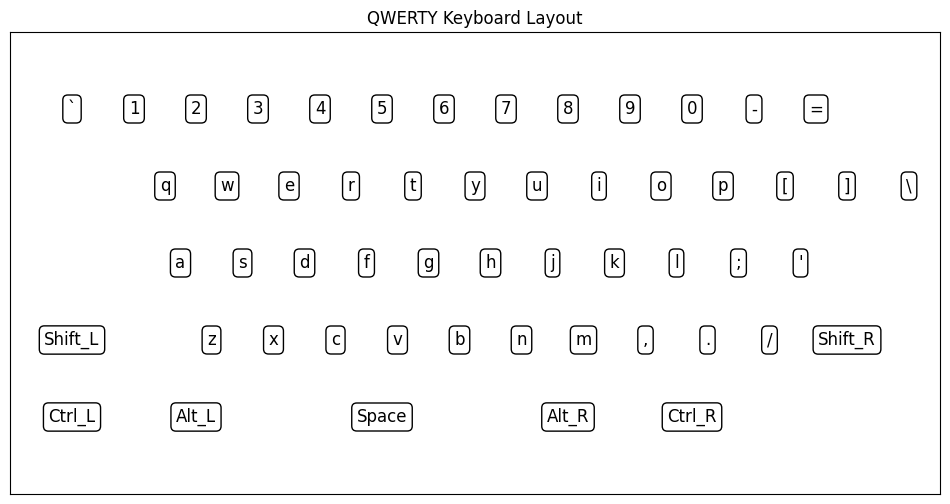

In [3]:
import matplotlib.pyplot as plt

def plot_keyboard(keys, title="Keyboard Layout"):
    plt.figure(figsize=(12, 6))
    
    for key, info in keys.items():
        x, y = info['pos']  # Get the position of the key
        plt.text(x, y, key, ha='center', va='center', fontsize=12, 
                 bbox=dict(facecolor='white', edgecolor='black', boxstyle='round,pad=0.3'))
    
    # Set plot limits and labels
    plt.xlim(-1, 14)
    plt.ylim(-1, 5)
    plt.title(title)
    
    # Remove ticks and labels from axes
    plt.xticks([])
    plt.yticks([])
    
    plt.show()

# Example usage
plot_keyboard(keys, title="QWERTY Keyboard Layout")


In [4]:
def distance(key1,key2): #function to calculat distance from coordinates
    distance = ((key1[0]-key2[0])**2+(key1[1]-key2[1])**2)**0.5
    return distance

In [5]:
def calc_distance(user_input, keys, characters):  #function to calculate distance travelled for the input string
    dist = 0
    for i in user_input:
        values = characters[i]
    
        for value in values:
            pos1 = keys[value]['pos'] 
            start_key = keys[value]['start']
            pos2 = keys[start_key]['pos']
            dist += distance(pos1,pos2)
    return dist

In [6]:
user_input = input("Enter something: ")
user_input = user_input.replace(
    " ", ""
)  # remove spaces in the input to ensure proper distance calculation

Enter something:  The rain miight stop in time but that does not mean schools will reopen. Life will take some time to get back to normal after this cyclone.


In [7]:
# Function to generate a neighbor layout by swapping two keys
def generate_new_layout(layout):
    new_layout = copy.deepcopy(layout)  # Create a copy of the current layout
    keys = list(new_layout)
    
    # Select two distinct keys to swap
    key1, key2 = random.sample(keys, 2)
    # Swap their positions
    
    new_layout[key1]['pos'], new_layout[key2]['pos'] = new_layout[key2]['pos'], new_layout[key1]['pos']
    for key in layout:
        if new_layout[key]['start']==key1:
            new_layout[key]['start']='temp'
    for key in layout:
        if new_layout[key]['start']==key2:
            new_layout[key]['start']=key1
    for key in layout:
        if new_layout[key]['start']=='temp':
            new_layout[key]['start']=key2   
    
    return new_layout

In [8]:
# Simulated annealing algorithm
def simulated_annealing(keys, initial_temp, cooling_rate, num_iterations):
    current_keys = keys
    current_distance = calc_distance(user_input,keys,characters)
    
    best_keys = copy.deepcopy(current_keys)
    best_distance = current_distance
    
    temp = initial_temp
    distances = [current_distance]
    best_layouts = [copy.deepcopy(best_keys)]
    best_distances = [best_distance]
    
    for i in range(num_iterations):
        new_layout = generate_new_layout(current_keys)
        new_distance = calc_distance(user_input,new_layout,characters)
        
        p = np.exp((current_distance - new_distance) / temp)
        # print(f"Prob[{i} = {p}")
        if new_distance < current_distance or random.random() < p:
            current_keys = new_layout
            current_distance = new_distance
            
            if current_distance < best_distance:
                best_keys = copy.deepcopy(current_keys)
                best_distance = current_distance
        
        temp *= cooling_rate
        distances.append(current_distance)
        best_layouts.append(copy.deepcopy(best_keys))
        best_distances.append(best_distance)
        
    return best_layouts, best_distances, distances

In [9]:
def update(frame, best_distances, current_distances, distance_line, cur_dist_line):
    
    distance_line.set_data(range(frame + 1), best_distances[:frame + 1])  
    cur_dist_line.set_data(range(frame + 1), current_distances[:frame + 1])
    
    return distance_line, cur_dist_line

In [17]:
# Main function to run the algorithm and create the animation
def main():
    #run the code
    initial_temp = 10
    cooling_rate = 0.995
    num_iterations = 500
    best_layouts, best_distances, current_distances = simulated_annealing(keys, initial_temp, cooling_rate, num_iterations)

    plot_keyboard(best_layouts[-1], title="Final Optimized Layout")
    # Set up the figure and subplots
    fig, ax = plt.subplots(figsize=(8, 6))
    fig.suptitle("Best Distance over Iterations", fontsize=14)

    # Distance subplot
    ax.set_xlim(0, num_iterations)
    ax.set_ylim(min(current_distances) * 0.9, max(current_distances) * 1.1)
    ax.set_title("Best Distance over Iterations")
    ax.set_xlabel("Iteration")
    ax.set_ylabel("Distance")
    distance_line, = ax.plot([], [], 'r-')
    cur_dist_line, = ax.plot([], [], 'g-')

    # Create the animation
    anim = FuncAnimation(fig, update, frames=range(0, num_iterations, 1), 
                         fargs=(best_distances, current_distances, distance_line, cur_dist_line),
                         interval=50, blit=True, repeat=False)
    return anim
    # Use plt.show() if running as a script
    # plt.tight_layout()
    # plt.show()
    

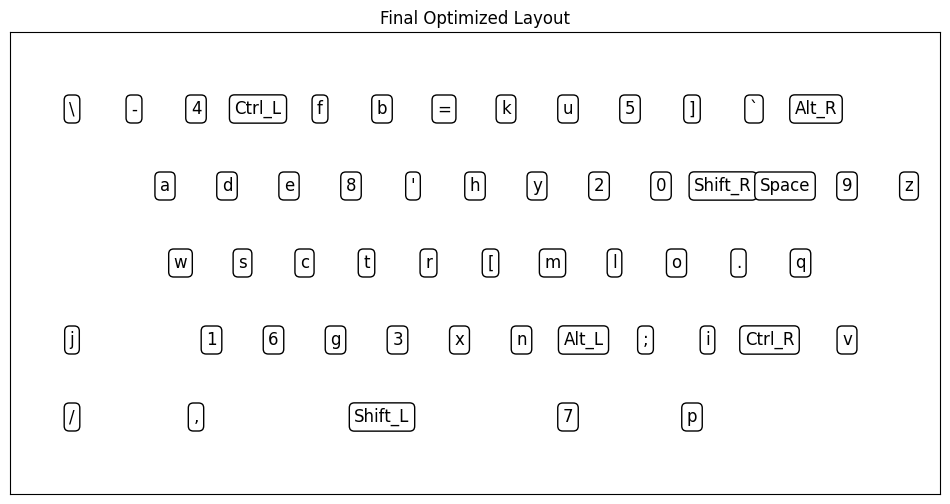

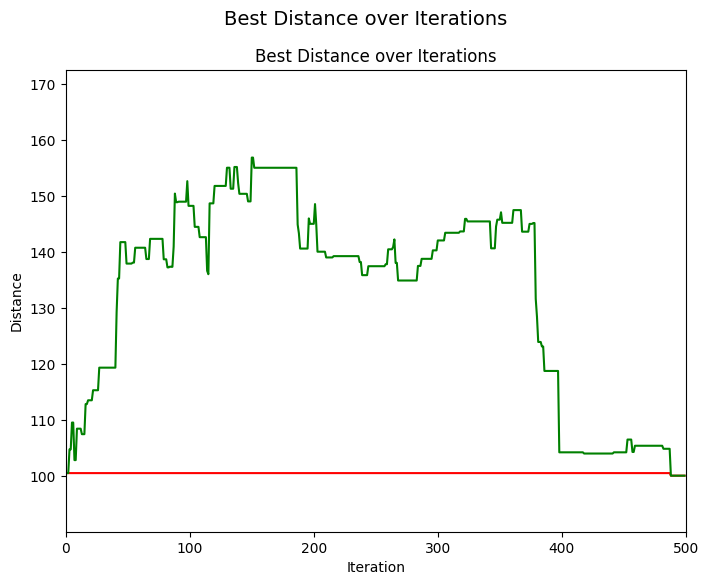

In [18]:
anim = main()
from IPython.display import HTML
HTML(anim.to_jshtml())